## <span style="color:#730101">Exploratory Data Analysis</span>

In this notebook, we provide insight into data by creating tables and plots.

##### <span style="color:#3A3A3A">Import Libraries</span>

In [1]:
import numpy as np
import pandas as pd
import json
import pickle
import os
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
from IPython.display import display
from wordcloud import WordCloud
from collections import Counter
from typing import Tuple, List
import folium  
import folium.plugins as plugins

def set_pandas_display_options() -> None:
    """Set pandas display options."""
    display = pd.options.display
    display.max_columns = 500
    display.max_rows = 500
    display.max_colwidth = 100
    display.width = None

set_pandas_display_options()

# import warnings filter
from warnings import simplefilter
# ignore all future warnings
simplefilter(action='ignore', category=FutureWarning)

##### <span style="color:#3A3A3A">Import Dataset</span>

In [2]:
# Import Dataset
with open('Nevada.pkl', 'rb') as nevada:
    Nevada = pickle.load(nevada)

In [3]:
display(Nevada.head(3))

,review_id,user_id,business_id,review_stars,text,date,business_name,address,city,state,postal_code,latitude,longitude,rating,attributes,categories,user_name,average_stars,LemaText,cuisines,input_text
0,izOSwMP2js_ptjDQZsynig,KriIEvoyWwhoswBoqqUpzA,faPVqws-x-5k2CQKDNtHxw,5,We just recently returned from Las Vegas and had the pleasure of stopping by your restaurant on ...,2019-12-13 15:34:17,Yardbird Southern Table & Bar,3355 Las Vegas Blvd S,LAS VEGAS,NV,89109,36.122328,-115.170112,4.5,"{'BusinessAcceptsCreditCards': 'True', 'BikeParking': 'True', 'OutdoorSeating': 'False', 'Restau...","restaurants, american (new), southern, nightlife, bars, cocktail bars",Christine,5.00,return las pleasure stop restaurant lunch seat lounge amaze server order lunch long cold server ...,american,return las pleasure stop restaurant lunch seat lounge amaze server order lunch long cold server ...
1,qUxCvPEkl7xrmY-n1szciA,D3XxyNOy8b_1484Oi1eYOg,VrGI7_nRjXpn0415S3coGQ,5,I've been here three times now one of my coworkers introduced me to this place the staff are ver...,2019-12-13 15:32:07,Vegas Noodle House,3516 Wynn Rd,LAS VEGAS,NV,89103,36.125887,-115.194425,4.0,"{'RestaurantsDelivery': 'True', 'GoodForKids': 'True', 'RestaurantsGoodForGroups': 'True', 'Rest...","restaurants, vegetarian, thai, noodles",Aaron,3.88,time place staff friendly restaurant clean soup delicious area bite eat highly soup,thai,time place staff friendly restaurant clean soup delicious area bite eat highly soup thai
2,oBbpt5C7BwKaTXy6ylzJ_g,cvA8vHPR0Gs0zsPnyv6JEQ,dVp1llwjZUmhCF4pNsJnQg,4,"When we walked in, we noticed that the decor was nice, and the restaurant was clean. Hubby and I...",2019-12-13 15:29:12,The Modern Vegan,700 E Naples Dr,LAS VEGAS,NV,89119,36.105993,-115.149127,4.0,"{'RestaurantsAttire': ''casual'', 'ByAppointmentOnly': 'False', 'BikeParking': 'True', 'Restaura...","vegan, restaurants, breakfast & brunch, american (new), american (traditional)",Taheerah,3.89,nice restaurant clean hubby menu heaven order chicken waffle order breakfast burrito honest brea...,american,nice restaurant clean hubby menu heaven order chicken waffle order breakfast burrito honest brea...


##### <span style="color:#3A3A3A">Exploration of Users</span>

Let us take a look on the users by seeing the activity of the most active of them.

In [4]:
user_agg=Nevada.groupby(['user_id','user_name']).agg({'review_id':['count'],'date':['min','max'],'review_stars':['mean']})
user_agg=user_agg.sort_values([('review_id','count')],ascending=False)
print("                                Top 10 Users in Yelp Dataset")
user_agg.head(10)
#x.to_excel(r'top_users.xlsx')

                                Top 10 Users in Yelp Dataset


review_id                date  \
                                     count                 min   
user_id                user_name                                 
bLbSNkLggFnqwNNzzq-Ijw Stefany         814 2012-05-20 19:50:41   
PKEzKWv_FktMm2mGPjwd0Q Norm            505 2008-12-12 02:35:45   
UYcmGbelzRa0Q6JqzLoguw Emily           364 2010-11-04 21:55:40   
U4INQZOPSUaj8hMjLlZ3KA Michael         314 2008-06-01 02:19:17   
JaqcCU3nxReTW2cBLHounA Zachary         309 2016-01-01 21:28:09   
_VMGbmIeK71rQGwOBWt_Kg Chris           291 2010-02-03 07:01:13   
tH0uKD-vNwMoEc3Xk3Cbdg Cathy           286 2012-08-11 15:01:51   
3nIuSCZk5f_2WWYMLN7h3w Lauren          285 2015-06-07 16:02:18   
n86B7IkbU20AkxlFX_5aew Jade            271 2010-02-21 08:09:07   
C2C0GPKvzWWnP57Os9eQ0w Clint           270 2009-07-06 05:06:54   

                                                     review_stars  
                                                 max         mean  
user_id                user_name                                   
bLbSNkLggFnqwNNzzq-Ijw Stefany   2019-11-19 17:37:28     3.431204  
PKEzKWv_FktMm2mGPjwd0Q Norm      2019-11-29 19:22:46     3.613861  
UYcmGbelzRa0Q6JqzLoguw Emily     2019-10-15 17:15:31     3.541209  
U4INQZOPSUaj8hMjLlZ3KA Michael   2019-12-03 12:24:36     3.821656  
JaqcCU3nxReTW2cBLHounA Zachary   2019-11-04 18:50:11     3.770227  
_VMGbmIeK71rQGwOBWt_Kg Chris     2019-12-11 03:27:51     3.986254  
tH0uKD-vNwMoEc3Xk3Cbdg Cathy     2019-10-13 22:24:41     3.839161  
3nIuSCZk5f_2WWYMLN7h3w Lauren    2019-11-05 23:07:54     3.978947  
n86B7IkbU20AkxlFX_5aew Jade      2017-11-16 19:30:20     3.675277  
C2C0GPKvzWWnP57Os9eQ0w Clint     2018-05-28 04:55:22     3.677778

##### <span style="color:#3A3A3A">Exploration of Cities</span>

In [5]:
cities = Nevada.city
# Calculate the number of times the city appears
counts = cities.value_counts()
# Calculate number of unique businesses per city
unique_businesses =  Nevada.groupby('city')['business_id'].nunique()
# Calculate the average stars per city
avg_stars = round(Nevada.groupby('city')['review_stars'].mean(),2)
# Calculate number of average reviews per city
avg_reviews = round((counts/unique_businesses),2)
table=pd.DataFrame({'Number of Reviews':counts,
                    'Average Number of Reviews':avg_reviews,
                    'Number of Businesses':unique_businesses,
                    'Average stars per review':avg_stars}).sort_values(by=['Number of Businesses'], ascending=False)
display(table)

,Number of Reviews,Average Number of Reviews,Number of Businesses,Average stars per review
LAS VEGAS,909689,321.44,2830,3.86
HENDERSON,81571,221.66,368,3.83
NORTH LAS VEGAS,18241,116.18,157,3.58
BOULDER CITY,4293,178.88,24,4.22


Las Vegas, in the state of Nevada, has the most businesses followed by Henderson city. It is worth mentioning the high number of reviews that characterize the businesses of Las Vegas. What is more, every city has over 100 reviews average number of reviews per business.

In [6]:
# Create interactive map with default basemap

data=[]
# Rearrange data to suit the format needed for folium
stars_list=list(Nevada['review_stars'].unique())
for star in stars_list:
    subset=Nevada[Nevada['review_stars']==star]
    data.append(subset[['latitude','longitude']].values.tolist())
    
# Initialize at Las Vegas (Google Coordinates)
lat = 36.127430 
lon = -115.138460 
zoom_start=10
print("Las Vegas Review Map")

# basic map
m = folium.Map(location=[lat, lon], tiles="OpenStreetMap", zoom_start=zoom_start)
# Show variations across star ratings 
hm = plugins.HeatMapWithTime(data,max_opacity=0.3,auto_play=True,display_index=True,radius=7)
hm.add_to(m)
m

Las Vegas Review Map


##### <span style="color:#3A3A3A">Exploration of Cuisines</span>

In [7]:
# Find the top-10 cuisines in Nevada regarding their number of reviews
most_common_cuisines = Counter(" ".join(Nevada['cuisines']).split(" ")).most_common()
top10_cuisines = most_common_cuisines[0:10]
display(top10_cuisines)

[('american', 443459),
 ('mexican', 134194),
 ('japanese', 130244),
 ('italian', 115787),
 ('asian', 100142),
 ('chinese', 80310),
 ('korean', 42394),
 ('french', 38635),
 ('thai', 38349),
 ('mediterranean', 33491)]

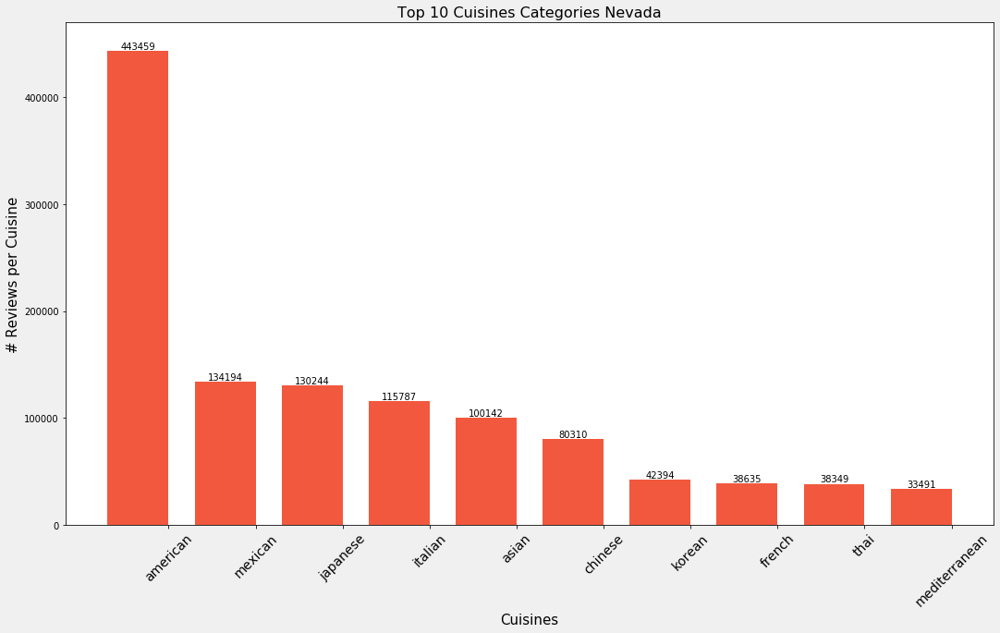

In [8]:
# Create a barplot to see the distribution of the number of reviews per cuisine.

data = top10_cuisines
names, values = zip(*data) 
ind = np.arange(len(data))  # the x locations for the groups
width = 0.7      # the width of the bars

# Create matplotlib figure
fig = plt.figure(figsize=(18,10),facecolor='#F0F0F0') 
# Create matplotlib axes
ax = fig.add_subplot(111) 

rects1 = ax.bar(ind, values, width, color='#F2583E')

# Add some text for labels, title and axes ticks
ax.set_ylabel('Count')
ax.set_xticks(ind+width/2.)
ax.set_xticklabels(names)

def autolabel(rects):
    # attach some text labels
    for rect in rects:
        height = rect.get_height()
        ax.text(rect.get_x() + rect.get_width()/2., 1.0*height,
                '%d' % int(height),
                ha='center', va='bottom')

autolabel(rects1)

# Set properties of gridlines
ax.grid(color='grey', linestyle='-', linewidth=0, alpha=1.0)
# The label of the x-axis
ax.set_xlabel("Cuisines", fontsize=15)
# The label of the y-axis
ax.set_ylabel("# Reviews per Cuisine", fontsize=15)
# The title of the plot
ax.set_title("Top 10 Cuisines Categories Nevada", fontsize=16)
# Set y axes limits
ax.set_ylim([0,470000])
# Set rotation of x-ticks
plt.xticks(rotation=45,fontsize=14)
#plt.savefig("top10cuisines.png")
plt.show()

The american cuisine, followed by the mexican and the japanese, seem to have the most reviews in our dataset.

In [9]:
unique_businesses = Nevada[['business_id','business_name','cuisines']].reset_index(drop=True)
unique_businesses = unique_businesses.drop_duplicates('business_id', keep='last')
unique_businesses.shape

(3379, 3)

In [10]:
unique_businesses = Nevada[['business_id','business_name','cuisines']].reset_index(drop=True)
unique_businesses = unique_businesses.drop_duplicates('business_id', keep='last')

cat = Counter(" ".join(unique_businesses['cuisines']).split(" ")).most_common()

table = pd.DataFrame(cat, columns =['Cuisines', 'count'])
cuisines = table.Cuisines

count = table['count'].astype(str)
percent100 = (table['count'] / table['count'].sum()).mul(100).round(1).astype(str)# + '%'
cuisines_freq = pd.DataFrame({'cuisines':cuisines,'count':count, 'per100':percent100})

cuisines_freq

,cuisines,count,per100
0,american,1236,30.2
1,mexican,816,19.9
2,chinese,360,8.8
3,italian,348,8.5
4,japanese,292,7.1
5,asian,252,6.2
6,thai,120,2.9
7,mediterranean,117,2.9
8,hawaiian,107,2.6
9,korean,89,2.2


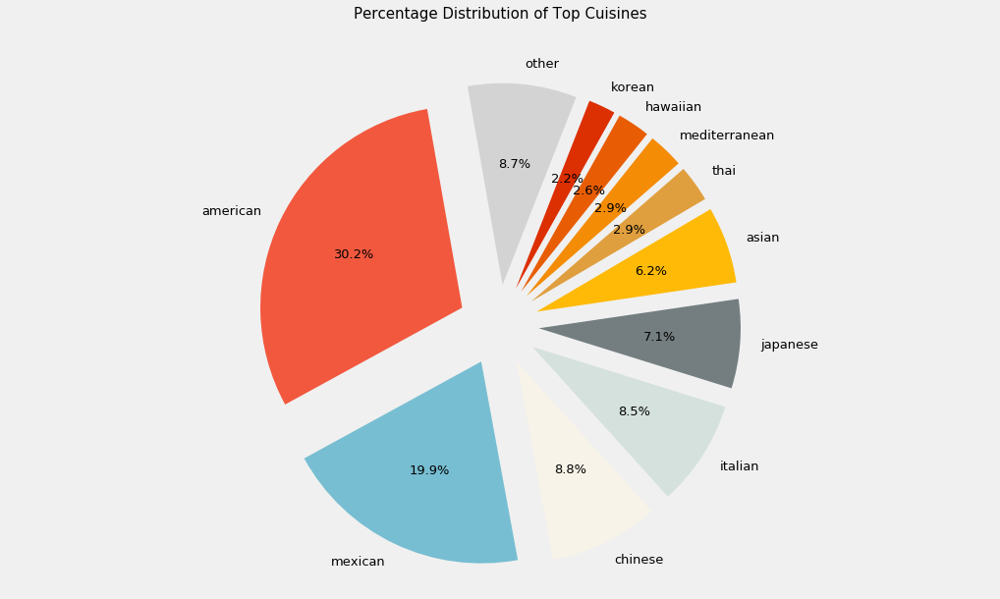

In [11]:
labels = 'american' , 'mexican', 'chinese', 'italian', 'japanese','asian','thai','mediterranean','hawaiian','korean','other'
sizes = [1236,816,360,348,292,252,120,117,107,89,357]
explode = (0.2, 0.2, 0.2, 0.2,0.2, 0.2, 0.2, 0.2, 0.2, 0.2, 0.2)

# Create matplotlib figure
fig = plt.figure(figsize=(18,10),facecolor='#F0F0F0') 
# Create matplotlib axes
ax = fig.add_subplot(111) 

# Creating color parameters 
colors = ( "#F2583E", "#77BED2", "#F7F3E8", "#D5E1DD", "#747E80","#ffba08", "#e09f3e", "#f48c06", "#e85d04", "#dc2f02","#d3d3d3") 

ax.pie(sizes,
        explode = explode,
        labels = labels,
        autopct = '%1.1f%%',
        shadow = False,
        startangle = 100,
        colors=colors, textprops={'fontsize': 13})

ax.axis ('equal')
# The title of the plot
ax.set_title("Percentage Distribution of Top Cuisines", fontsize=15, pad=40)
#plt.savefig("unique_cuisines_pie.png")
plt.show()

##### <span style="color:#3A3A3A">Exploration of Reviews</span>

In [12]:
# Take a loon on the most common words that appear in the dataset.
most_common = Counter(" ".join(Nevada['input_text']).split(" ")).most_common()
most_common

[('food', 809087),
 ('good', 635837),
 ('not', 626137),
 ('place', 548552),
 ('great', 477284),
 ('service', 447625),
 ('american', 443460),
 ('order', 442339),
 ('time', 397114),
 ('restaurant', 233719),
 ('chicken', 219049),
 ('eat', 209126),
 ('best', 203083),
 ('no', 196012),
 ('delicious', 194996),
 ('menu', 176316),
 ('nice', 172791),
 ('table', 172562),
 ('wait', 166668),
 ('love', 162858),
 ('taste', 150789),
 ('friendly', 135246),
 ('mexican', 134197),
 ('staff', 133131),
 ('experience', 132951),
 ('japanese', 130245),
 ('amaze', 123342),
 ('pretty', 123322),
 ('sauce', 121974),
 ('server', 121293),
 ('meal', 119186),
 ('fresh', 118875),
 ('italian', 115787),
 ('people', 115439),
 ('dinner', 112397),
 ('night', 112012),
 ('price', 111646),
 ('bad', 110716),
 ('bar', 110279),
 ('salad', 105587),
 ('recommend', 102566),
 ('cheese', 100916),
 ('asian', 100142),
 ('rice', 98201),
 ('lunch', 97759),
 ('day', 94578),
 ('well', 90807),
 ('lot', 90768),
 ('flavor', 89261),
 ('favorite

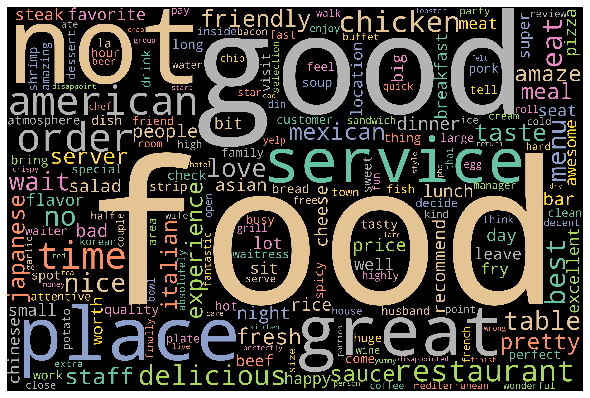

In [13]:
# Make a wordcloud from the occurence of every word in the dataset
# Convert reviews to a dictionary of words with values and items the occurence of every word
word_could_dict = Counter(" ".join(Nevada['input_text']).split(" "))
word_could_dict

# Generate wordcloud
wordcloud = WordCloud(width = 3000, height = 2000, random_state=1, background_color='black', colormap='Set2', collocations=False).generate_from_frequencies(word_could_dict)

# plot the WordCloud image                        
plt.figure(figsize = (8, 8), facecolor = None) 
plt.imshow(wordcloud) 
plt.axis("off") 
plt.tight_layout(pad = 0) 

plt.show()

In [14]:
# Save image
#wordcloud.to_file("wordcloud.png")

In [15]:
Nevada['month'] = Nevada['date'].dt.month
labels = 'January' , 'February', 'March', 'April', 'May', 'June', 'July', 'August', 'September', 'October', 'November', 'December'
plot_months = Nevada.groupby([Nevada['month']], sort=True).count().eval('review_id')

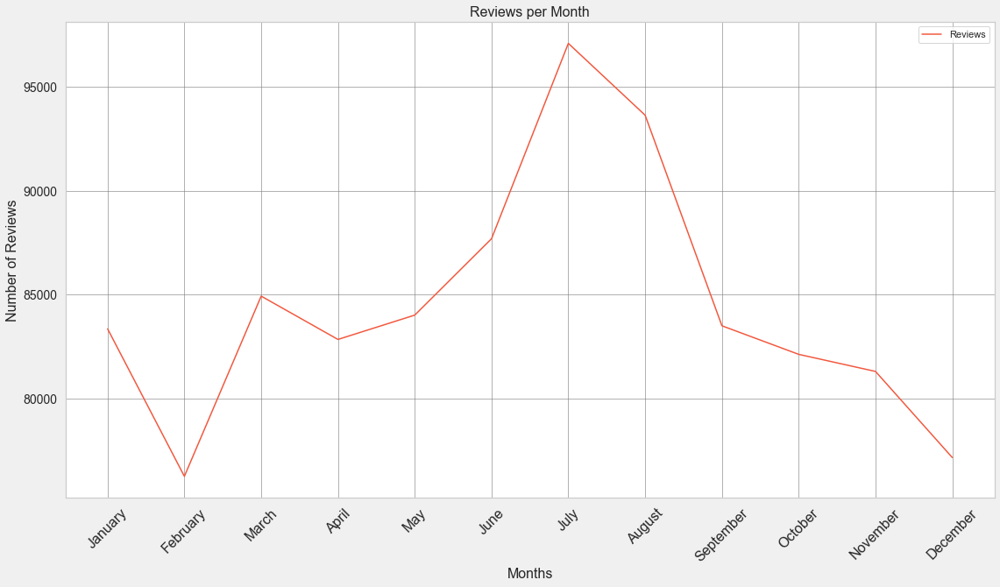

In [16]:
sns.set(style="whitegrid")
# Create matplotlib figure
fig = plt.figure(figsize=(19,10),facecolor='#F0F0F0') 
# Create matplotlib axes
ax = fig.add_subplot(111)
ax.grid(color='grey', linestyle='-', linewidth=0.6, alpha=1.0)

# Create a sample dataframe with an text index
plotdata = pd.DataFrame(
    {"Reviews":np.stack(plot_months).astype(None) }, 
    index=['January' , 'February', 'March', 'April', 'May', 'June', 'July', 'August', 'September', 'October', 'November', 'December'])
# Plot a bar chart

x1 = [0,1,2,3,4,5,6,7,8,9,10,11]
months=['January' , 'February', 'March', 'April', 'May', 'June', 'July', 'August', 'September', 'October', 'November', 'December']

plotdata.plot(kind="line",color='#F2583E', ax=ax, fontsize=14)
plt.title("Reviews per Month", fontsize=16)
plt.xlabel("Months", fontsize=16)
plt.ylabel("Number of Reviews", fontsize=16)
ax.set_xticks(x1)
ax.set_xticklabels(months, minor=False, rotation=45, fontsize=16, horizontalalignment="center")
plt.grid(True)
#plt.savefig("month_plot2.png")
plt.show()

##### <span style="color:#3A3A3A">Exploration of Ratings</span>

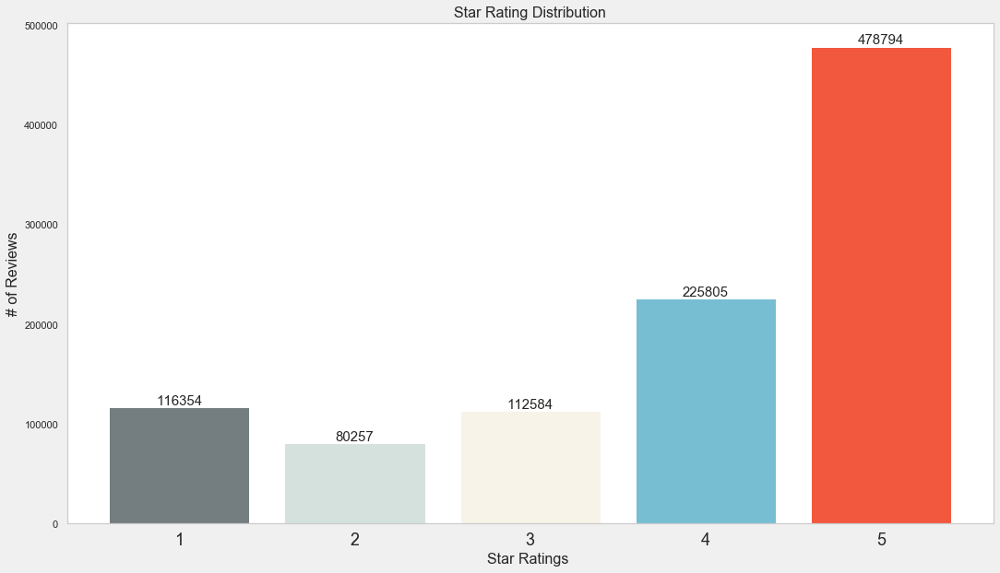

In [17]:
#Get the distribution of the ratings
x=Nevada['review_stars'].value_counts()

x=x.sort_index()

# Create matplotlib figure
fig = plt.figure(figsize=(18,10),facecolor='#F0F0F0') 
# Create matplotlib axes
ax = fig.add_subplot(111) 

colors = ( "#747E80", "#D5E1DD", "#F7F3E8", "#77BED2", "#F2583E") 
#plot
#plt.figure(figsize=(8,4))
ax.bar(x.index, x.values, alpha=1, color=colors)
plt.title("Star Rating Distribution", fontsize=16)
plt.ylabel('# of Reviews', fontsize=16)
plt.xlabel('Star Ratings ', fontsize=16)

#adding the text labels
rects = ax.patches
labels = x.values
for rect, label in zip(rects, labels):
    height = rect.get_height()
    ax.text(rect.get_x() + rect.get_width()/2, height + 5, label, ha='center', va='bottom', fontsize=15)
    
plt.grid(False)    
plt.xticks(fontsize=18)
#plt.savefig("rating_barplot.png")
plt.show()

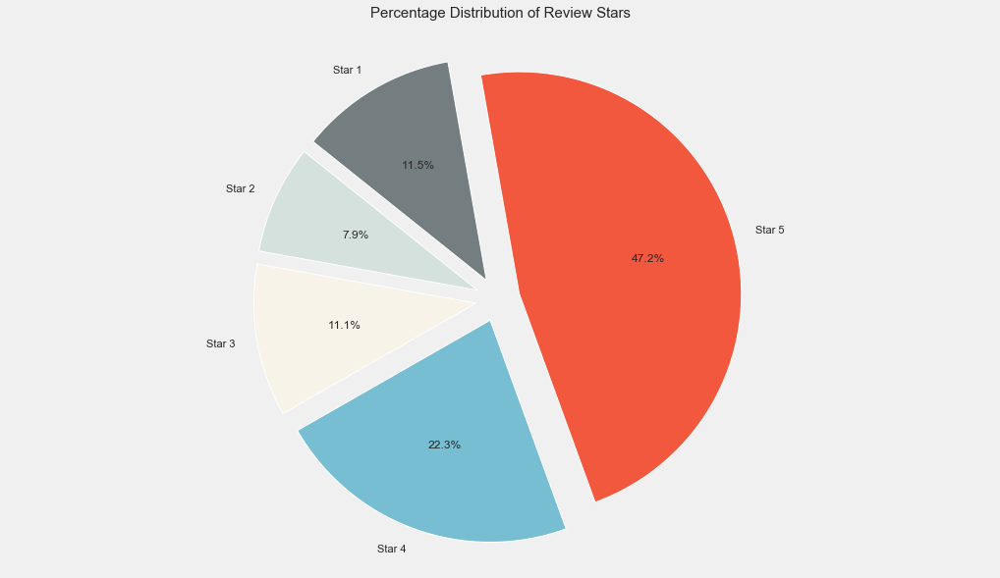

In [18]:
labels = 'Star 1' , 'Star 2', 'Star 3', 'Star 4', 'Star 5'
sizes = [116354,80257,112584,225805,478794]
explode = (0.1, 0.1, 0.1, 0.1, 0.1)

# Create matplotlib figure
fig = plt.figure(figsize=(18,10),facecolor='#F0F0F0') 
# Create matplotlib axes
ax = fig.add_subplot(111) 

# Creating color parameters 
colors = ( "#747E80", "#D5E1DD", "#F7F3E8", "#77BED2", "#F2583E") 

ax.pie(sizes,
       explode = explode,
       labels = labels,
       autopct = '%1.1f%%',
       shadow = False,
       startangle = 100,
       colors = colors)

ax.axis ('equal')
# The title of the plot
ax.set_title("Percentage Distribution of Review Stars", fontsize=15, pad=20)
#plt.savefig("stars_pie.png")
plt.show()